In [1]:
import pandas_datareader.data as web
import datetime
import pandas as pd
import numpy as np
import yfinance as yf

import yfinance as yf
data = yf.download("F", start="2014-01-01", end="2019-01-01")
data['pct_change'] = data['Adj Close'].pct_change()
data['log_ret'] = np.log(data['Adj Close']) - np.log(data['Adj Close'].shift(1))
data=data.dropna()
data.tail(5)

c:\users\user\appdata\local\programs\python\python37\lib\site-packages\pandas_datareader\compat\__init__.py:7: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  from pandas.util.testing import assert_frame_equal


[*********************100%***********************]  1 of 1 completed


,Open,High,Low,Close,Adj Close,Volume,pct_change,log_ret
Date,,,,,,,,
2018-12-24,8.01,8.01,7.61,7.63,6.912900,38709500,-0.052174,-0.053584
2018-12-26,7.73,7.86,7.41,7.85,7.112223,58810000,0.028834,0.028426
2018-12-27,7.82,7.85,7.53,7.85,7.112223,49813000,0.000000,0.000000
2018-12-28,7.83,8.04,7.76,7.81,7.075983,47331700,-0.005096,-0.005109
2018-12-31,7.85,7.86,7.50,7.65,6.931020,57816000,-0.020487,-0.020699


In [2]:
import pandas_datareader.data as web
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from KDEpy import FFTKDE
import datetime

COLOR_CYCLE = plt.rcParams["axes.prop_cycle"].by_key()["color"]


In [7]:
# Compute the log returns and the weights
stock_data = data.log_ret
def weight_function(arr):
    k = 0.005
    return 0.045 * np.exp(-arr * k)

points = ( list(range(1, 20))
    + list(range(20, 100, 2))
    + list(range(100, 300, 3))
    + list(range(300, 600, 3))
    + list(range(600, 900, 5))
    + list(range(900, len(stock_data), 5)))
stock_data=np.array(stock_data).reshape(1258,1)
weights = weight_function(np.arange(0, len(stock_data)))

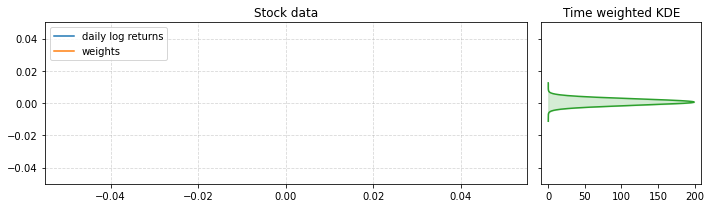

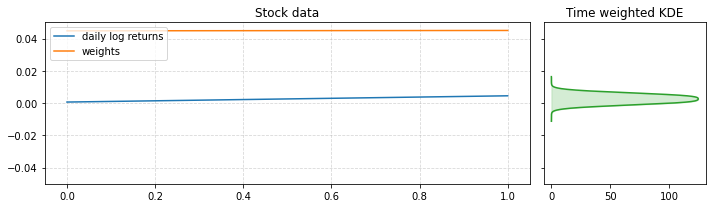

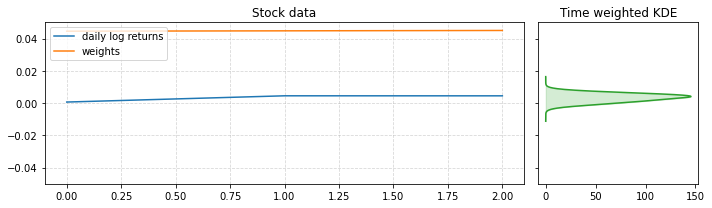

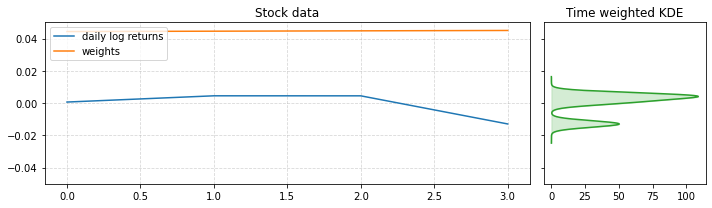

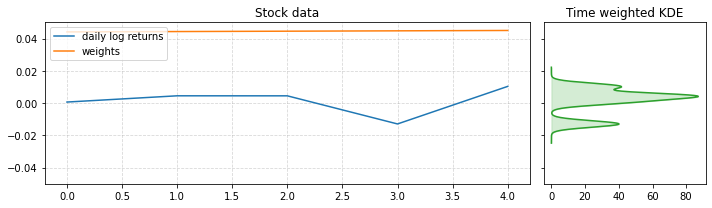

...

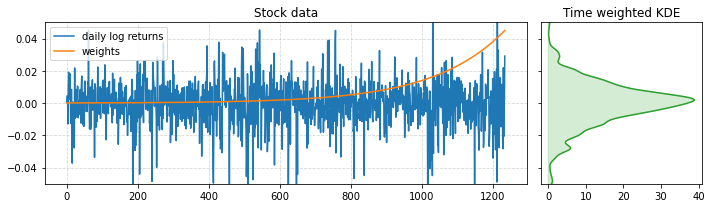

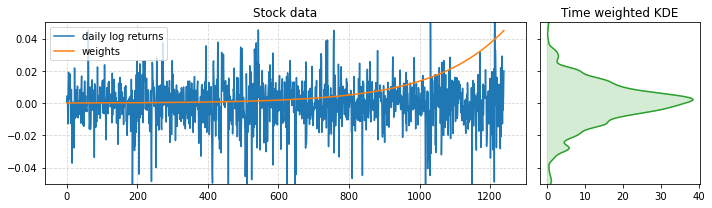

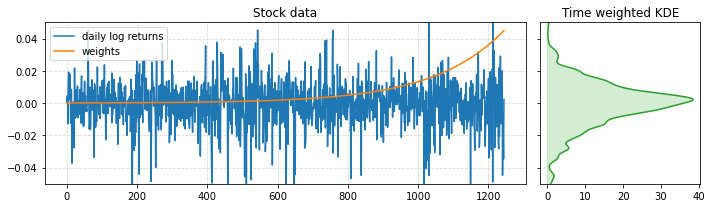

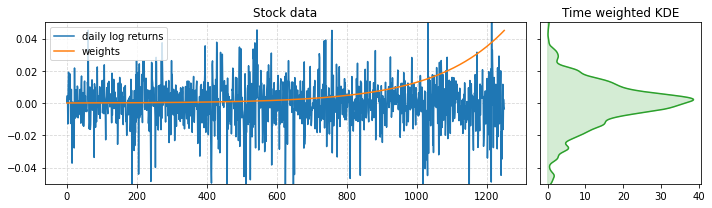

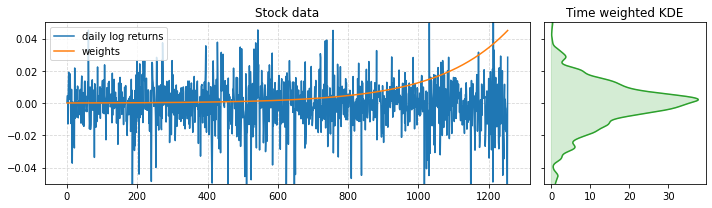

In [9]:
for i, num_points in enumerate(points):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 3), gridspec_kw={"width_ratios": [3, 1]}, sharey="row")
    # Create a kernel density estimate, the bandwidth is found by trial and error
    x, y = (FFTKDE(bw=0.002).fit(stock_data[:num_points], weights=weights[num_points - 1 :: -1]).evaluate())
    if i == len(points) - 1:
        x=x
        y=y

    # The left-most plot
    ax1.set_title("Stock data")
    ax1.plot(stock_data[:num_points], label="daily log returns")
    ax1.plot(np.arange(num_points), weights[num_points - 1 :: -1], label="weights")
    ax1.set_ylim([-0.05, 0.05])
    ax1.grid(True, zorder=5, alpha=0.5, ls="--")
    ax1.legend(loc="upper left")

    # The right-most plot
    ax2.set_title("Time weighted KDE")
    ax2.plot(y, x, color=COLOR_CYCLE[2])
    ax2.fill_betweenx(x, 0, y, alpha=0.2, color=COLOR_CYCLE[2])

    # https://stackoverflow.com/questions/24767355/individual-alpha-values-in-scatter-plot
    rgba_colors = np.zeros((num_points, 4))
    # for red the first column needs to be one
    rgba_colors[:, 0] = 31 / 256
    rgba_colors[:, 1] = 119 / 256
    rgba_colors[:, 2] = 180 / 256
    # the fourth column needs to be your alphas
    rgba_colors[:, 3] = (weights[num_points - 1 :: -1] / (0.045)) ** 10

    # Save the figure
    plt.tight_layout()
    plt.show()



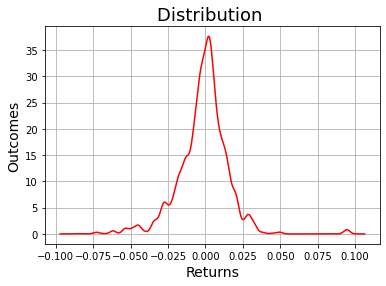

In [10]:
plt.plot(x,y,color= 'r')
plt.grid(True)
plt.title('Distribution ',fontsize=18)
plt.xlabel('Returns',fontsize=14)
plt.ylabel('Outcomes',fontsize=14)
plt.show()

In [17]:

def probability(x: np.ndarray, y: np.ndarray, k1: float, k2=None, greater_than=False) -> float:
    if greater_than == True:
        k2 = x[-1] if k2 is None else k2
        inter1p = []
        dt = (x.max()-x.min())/float(len(x))
        for h in np.arange(k1, k2, 0.0001):
            inter1p.append(np.interp(h, x, y))
        f = 0.5*dt*(inter1p[0]+inter1p[-1])+dt*np.sum(inter1p[1:-1])
        return f
    else:
        inter1p = []
        dt = (x.max()-x.min())/float(len(x))
        for h in np.arange(k1, k2, 0.0001):
            inter1p.append(np.interp(h, x, y))
        f = 0.5*dt*(inter1p[0]+inter1p[-1])+dt*np.sum(inter1p[1:-1])
        return 1-f

In [19]:
#probabilty that the losses will exceed 4.5%
probability(x,y,0.045,greater_than=False)

0.024464295486338217